In [1]:
import segmentation_models_pytorch as smp
import cv2
import torch
import rasterio
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap
from torchvision import transforms
import os


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
####################아래는 원본이미지에만 적용할 전처리####################
# 엣지 보강 (샤프닝)
def enhance_edges(image):
    image = np.array(image)  # PIL Image -> NumPy 배열로 변환
    kernel = np.array([[0, -1, 0],
                       [-1, 5, -1],
                       [0, -1, 0]])
    return Image.fromarray(cv2.filter2D(image, -1, kernel))  # NumPy 배열에서 필터링 후 PIL 이미지로 변환

# 채도 강화
def enhance_saturation(image, scale=1.5):
    image = np.array(image)  # PIL Image -> NumPy 배열로 변환
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)  # RGB -> BGR로 변환
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    s = cv2.multiply(s, scale)
    s = cv2.min(s, 255)
    hsv = cv2.merge((h, s, v))
    image = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)  # BGR -> HSV로 변환 후 다시 BGR로
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR -> RGB 변환
    return Image.fromarray(image)  # 결과를 PIL 이미지로 변환

# CLAHE
def enhance_clahe(image):
    image = np.array(image)  # PIL Image -> NumPy 배열로 변환
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)  # RGB -> BGR로 변환
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(2, 2))
    l = clahe.apply(l)
    lab = cv2.merge((l, a, b))
    image = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)  # LAB -> BGR로 변환 후
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR -> RGB 변환
    return Image.fromarray(image)  # 결과를 PIL 이미지로 변환

In [3]:
from sklearn.metrics import precision_score, recall_score, f1_score

def compute_metrics(outputs, masks, num_classes, class_names):
    """
    outputs: [H, W] - Model predictions (class indices)
    masks: [H, W] - Ground truth masks
    num_classes: Number of classes
    class_names: List of class names
    """
    iou_per_class = []
    precision_per_class = []
    recall_per_class = []
    f1_per_class = []
    correct_pixels = 0
    total_pixels = masks.numel()


    for cls in range(num_classes):
        ## IOU
        true_positive = ((outputs == cls) & (masks == cls)).sum().item()
        false_positive = ((outputs == cls) & (masks != cls)).sum().item()
        false_negative = ((outputs != cls) & (masks == cls)).sum().item()

        union = true_positive + false_positive + false_negative
        if union > 0:
            iou_per_class.append(true_positive / union)
        else:
            iou_per_class.append(0.0)

        ## Precision, Recall, F1 score
        pred_binary = (outputs == cls).flatten().cpu().numpy()
        mask_binary = (masks == cls).flatten().cpu().numpy()

        precision = precision_score(mask_binary, pred_binary, zero_division=0)
        recall = recall_score(mask_binary, pred_binary, zero_division=0)
        f1 = f1_score(mask_binary, pred_binary, zero_division=0)

        precision_per_class.append(precision)
        recall_per_class.append(recall)
        f1_per_class.append(f1)

    # Pixel Accuracy
    correct_pixels = (outputs == masks).sum().item()
    mean_iou = sum(iou_per_class) / num_classes
    pixel_accuracy = correct_pixels / total_pixels

    # Print metrics for each class
    for i, iou in enumerate(iou_per_class):
        print(f"Class {class_names[i]}: IoU={iou_per_class[i]:.4f}, Precision={precision_per_class[i]:.4f}, Recall={recall_per_class[i]:.4f}, F1-Score={f1_per_class[i]:.4f}")

    print(f"\nOverall Metrics: Mean IoU={mean_iou:.4f}, Pixel Accuracy={pixel_accuracy:.4f}")

    return mean_iou, pixel_accuracy, precision_per_class, recall_per_class, f1_per_class

In [4]:
def load_UNet_model(weight_path, num_classes, device):
    model = smp.UnetPlusPlus(
        encoder_name="resnet50",
        encoder_weights=None,
        classes=num_classes,
        activation=None
    )
    model.load_state_dict(torch.load(weight_path, map_location=device))
    model = model.to(device)
    model.eval()
    return model

def load_segformer_model(weight_path, num_classes, device):
    model = smp.Segformer(
        encoder_name="mit_b3",  # B3 variant of Segformer
        encoder_weights=None,  # Pre-trained weights are not loaded
        classes=num_classes,
        activation=None
    )
    model.load_state_dict(torch.load(weight_path, map_location=device))
    model = model.to(device)
    model.eval()
    return model

def preprocess_image(image, image_transform):
    image = Image.fromarray(image).convert("RGB")
    image = image_transform(image)
    return image.unsqueeze(0)

def preprocess_mask(mask, class_mapping):
    mask_array = np.array(mask)
    mapped_mask = np.zeros_like(mask_array, dtype=np.uint8)
    for old_class, new_class in class_mapping.items():
        mapped_mask[mask_array == old_class] = new_class
    return torch.tensor(mapped_mask, dtype=torch.long)

def visualize_result(image, prediction, colormap, class_names, title="Prediction"):
    cmap = ListedColormap(np.array(colormap) / 255.0)
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title("Original Image")
    plt.imshow(image)
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.title(title)
    plt.imshow(prediction, cmap=cmap)
    plt.axis("off")
    patches = [plt.Line2D([0], [0], color=np.array(c) / 255, lw=4) for c in colormap]
    plt.legend(patches, class_names, loc="upper center", bbox_to_anchor=(0.5, -0.05), ncol=5)
    plt.show()

In [5]:
def soft_voting_ensemble(prob_segformer, prob_unet, alpha=0.6):
    # alpha: Segformer와 UNet++의 가중치 (Segformer 60%, UNet++ 40%)
    combined_probs = (alpha * prob_segformer) + ((1 - alpha) * prob_unet)
    return np.argmax(combined_probs, axis=1)


# ✅ 클래스별 선택적 앙상블
def selective_ensemble(pred_segformer, pred_unet, road_class=1):
    final_prediction = pred_segformer.copy()
    final_prediction[pred_unet == road_class] = road_class  # 도로 클래스는 UNet++ 결과 채택
    return final_prediction

In [6]:
#노이즈 제거, 블러링
def postprocess_segmentation(mask, kernel_size, blur_ksize):
    mask = mask.astype(np.uint8)
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    mask_cleaned = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    mask_blurred = cv2.GaussianBlur(mask_cleaned, (blur_ksize, blur_ksize), 0)

    return mask_blurred

#엣지 검출
def create_edge_map(image, low_threshold, high_threshold):
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray_image, low_threshold, high_threshold)
    return edges

#####################탐색 판단 알고리즘#######################
def refine_labels(edge_map, label_map, num_classes, class_mapping):
    height, width = edge_map.shape
    refined_label_map = np.copy(label_map)
    DR = 0.7  # Dominative Rate 설정

    # 8방향 탐색을 위한 델타값 설정
    directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]

    for y in range(1, height - 1):
        for x in range(1, width - 1):
            if edge_map[y, x] == 255:  #강한 에지 픽셀인 경우
                current_label = label_map[y, x]
                labels_around = [label_map[y + dy][x + dx] for dy, dx in directions]
                label_counts = np.bincount(labels_around, minlength=num_classes)
                max_label = np.argmax(label_counts)

                # 조건 1: 주변에서 가장 많이 나타난 레이블로 변경
                if max_label != current_label:
                    refined_label_map[y, x] = max_label
                    continue

                # 조건 2: 경계직선화 : DR 적용
                a = np.sum(np.array(labels_around) != current_label)
                b = label_counts[max_label]
                distance = np.sum(label_counts)

                if a < b and b/distance >= DR:
                    refined_label_map[y, x] = max_label
                    continue

                # 조건 3 : 작은 영역 (노이즈 제거)
                if len(label_counts) > 2:
                    second_max_label = np.argsort(label_counts)[-2]
                    if b <= 5 and refined_label_map[y, x] == second_max_label:
                        refined_label_map[y, x] = max_label

                # 예: 연속된 레이블 변화 확인, 레이블 지배도 검사 등
    return refined_label_map
############################################################

#불확실성 기반 후처리
def uncertainty_based_refine(prediction, softmax_output, threshold):
    refined_prediction = prediction.copy()

    # 확신이 낮은 픽셀 찾기 (softmax 값이 threshold보다 낮으면 불확실)
    max_confidence = np.max(softmax_output, axis=1)
    uncertainty_mask = np.squeeze(max_confidence < threshold)  # 가장 높은 확률 값과 threshold 비교

    height, width = prediction.shape
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]

    for y in range(1, height - 1):
        for x in range(1, width - 1):
            if bool(uncertainty_mask[y, x]) : # 불확실한 픽셀일 경우
                surrounding_labels = [prediction[y + dy, x + dx] for dy, dx in directions]
                refined_prediction[y, x] = np.bincount(surrounding_labels).argmax()  # 주변에서 가장 많이 등장한 레이블로 변경

    return refined_prediction

# 도로 중점 불확실성 기반 후처리
def uncertainty_based_road_refine(prediction, softmax_output, threshold):
    refined_prediction = prediction.copy()

    # 도로 클래스(1)에서 확신이 낮은 픽셀 찾기
    road_class = 1
    max_confidence = np.max(softmax_output, axis=1)
    uncertainty_mask = (prediction == road_class) & (max_confidence < threshold)
    uncertainty_mask = np.squeeze(uncertainty_mask.astype(bool))

    # 주변 픽셀에서 가장 많이 등장하는 클래스로 보정
    height, width = prediction.shape
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]

    for y in range(1, height - 1):
        for x in range(1, width - 1):
            if uncertainty_mask[y, x]:
                surrounding_labels = [prediction[y + dy, x + dx] for dy, dx in directions]
                refined_prediction[y, x] = np.bincount(surrounding_labels).argmax()  # 다수결 결정

    return refined_prediction


In [7]:
# 컨투어링 직선화
def contour_simplification(label_map, epsilon, road_class = 1):
    refined_label_map = np.copy(label_map)
    # 도로(1) 클래스만 선택
    road_mask = (label_map == road_class).astype(np.uint8)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_TC89_KCOS)

    approx_mask = np.zeros_like(road_mask)
    for contour in contours:
        approx = cv2.approxPolyDP(contour, epsilon, True)  # 직선화된 컨투어 생성
        cv2.drawContours(approx_mask, [approx], -1, 1, thickness=cv2.FILLED)

    refined_label_map[approx_mask == 1] = road_class

    return refined_label_map

# 도로 윤곽선을 기반으로 세밀한 보정
def refine_road_with_contours(prediction, edge_map, road_class, min_area):
    refined_prediction = prediction.copy()

    # ✅ 도로 클래스만 선택
    road_mask = (prediction == road_class).astype(np.uint8)

    # ✅ 윤곽선 검출
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # ✅ 새로운 마스크 생성 (엣지 기반)
    refined_road_mask = np.zeros_like(road_mask)

    for contour in contours:
        if cv2.contourArea(contour) > min_area:  # 작은 노이즈 제거
            cv2.drawContours(refined_road_mask, [contour], -1, 1, thickness=cv2.FILLED)

    # ✅ 엣지맵과 AND 연산 → 엣지 부분만 남김
    refined_road_mask = refined_road_mask & (edge_map > 0)

    # ✅ 최종적으로 도로 클래스만 보정
    refined_prediction[refined_road_mask > 0] = road_class

    return refined_prediction


# 도로 Softmax 적용
def road_uncertainty_filling(prediction, softmax_output, threshold, road_class):
    refined_prediction = prediction.copy()

    # 도로 확률이 threshold 이상이면 도로로 채우기
    road_prob = softmax_output[0, road_class, :, :]
    missing_road = (road_prob > threshold) & (prediction != road_class)

    refined_prediction[missing_road] = road_class

    return refined_prediction

def adaptive_road_filling(prediction, softmax_output, base_threshold, road_class):
    refined_prediction = prediction.copy()
    road_prob = softmax_output[0, road_class, :, :]

    # ✅ 적응형 임계값 적용 (도로 중심부 vs 경계부)
    high_confidence_threshold = 0.5  # 중심부
    low_confidence_threshold = base_threshold  # 경계부 (기본값)

    # 1️⃣ 기존 도로 영역 확장
    high_confidence_mask = (road_prob > high_confidence_threshold) & (prediction == road_class)

    # 2️⃣ 주변 도로 예측을 확장 (False Positive 방지)
    low_confidence_mask = (road_prob > low_confidence_threshold) & (prediction != road_class)

    refined_prediction[high_confidence_mask] = road_class
    refined_prediction[low_confidence_mask] = road_class

    return refined_prediction


# 신뢰도 강화
def refine_road_with_edges(prediction, softmax_output, edge_map, threshold, road_class):
    refined_prediction = prediction.copy()
    road_prob = softmax_output[0, road_class, :, :]

    # ✅ 도로 예측값이 threshold 이상이고, 엣지맵에서도 검출된 영역만 보정
    edge_road_mask = (road_prob > threshold) & (edge_map > 0)

    refined_prediction[edge_road_mask] = road_class
    return refined_prediction


# 도로 연결, 끊김 제거
def connect_road_segments(label_map, road_class=1, kernel_size=5):
    road_mask = (label_map == road_class).astype(np.uint8)

    # ✅ 1. 모폴로지 연산 (Closing)으로 작은 단절 제거
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    closed_road = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)

    # ✅ 2. 다시 원본 라벨맵에 적용
    refined_label_map = label_map.copy()
    refined_label_map[closed_road == 1] = road_class

    return refined_label_map

# 소벨필터 보간
def interpolate_road_edges(label_map, road_class=1):
    road_mask = (label_map == road_class).astype(np.uint8)

    # 소벨 필터 적용
    sobel_x = cv2.Sobel(road_mask, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(road_mask, cv2.CV_64F, 0, 1, ksize=3)
    sobel_x = cv2.GaussianBlur(sobel_x, (3, 3), 0)
    sobel_y = cv2.GaussianBlur(sobel_y, (3, 3), 0)
    sobel_edges = np.sqrt(sobel_x**2 + sobel_y**2)
    edge_mask = (sobel_edges > 0).astype(np.uint8)

    # 도로 픽셀을 기준으로 보간
    refined_label_map = label_map.copy()
    for y in range(1, label_map.shape[0] - 1):
        for x in range(1, label_map.shape[1] - 1):
            if edge_mask[y, x]:  # 경계 픽셀인 경우
                neighbors = [label_map[y+dy, x+dx] for dy, dx in [(-1,0), (1,0), (0,-1), (0,1)]]
                road_count = sum(1 for n in neighbors if n == road_class)

                # 주변 도로 픽셀이 많으면 도로로 보정
                if road_count >= 2:
                    refined_label_map[y, x] = road_class

    return refined_label_map

# 방향성 고려하여 보정 (PCA 기반)
def directional_road_filter(label_map, road_class, min_length, angle_threshold, neighborhood_size):
    height, width = label_map.shape
    road_mask = (label_map == road_class).astype(np.uint8)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    refined_label_map = label_map.copy()
    directions = [(dy, dx) for dy in range(-neighborhood_size, neighborhood_size + 1)
                            for dx in range(-neighborhood_size, neighborhood_size + 1)
                            if not (dy == 0 and dx == 0)]  # 중심 제외

    for contour in contours:
        if len(contour) < min_length:
            continue

        contour_points = contour[:, 0, :]
        mean_x, mean_y = np.mean(contour_points, axis=0)
        cov_matrix = np.cov(contour_points.T)
        eig_values, eig_vectors = np.linalg.eig(cov_matrix)
        principal_direction = eig_vectors[:, np.argmax(eig_values)]
        road_angle = np.arctan2(principal_direction[1], principal_direction[0]) * (180 / np.pi)

        for point in contour_points:
            x, y = point
            if 0 <= y < height and 0 <= x < width:
                surrounding_labels = []
                surrounding_angles = []

                for dy, dx in directions:
                    ny, nx = y + dy, x + dx
                    if 0 <= ny < height and 0 <= nx < width:
                        surrounding_labels.append(label_map[ny, nx])
                        surrounding_angles.append(np.arctan2(dy, dx) * (180 / np.pi))

                if surrounding_labels:
                    most_common_label = np.bincount(surrounding_labels).argmax()
                    angle_diffs = np.abs(np.array(surrounding_angles) - road_angle)
                    aligned_count = np.sum(angle_diffs < angle_threshold)

                    # 방향성이 유지되는 경우 도로 유지
                    if aligned_count / len(surrounding_angles) > 0.5:
                        refined_label_map[y, x] = road_class
                    else:
                        refined_label_map[y, x] = most_common_label

    return refined_label_map

C:\Users\SIM2REAL\AppData\Local\Temp\ipykernel_17568\735151089.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(weight_path, map_location

Processing: LC_SN_36604_026.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)
Class Building: IoU=0.4788, Precision=0.6833, Recall=0.6153, F1-Score=0.6475
Class Road: IoU=0.4291, Precision=0.5331, Recall=0.6875, F1-Score=0.6005
Class Field: IoU=0.6640, Precision=0.8363, Recall=0.7632, F1-Score=0.7981
Class Forest: IoU=0.8424, Precision=0.9061, Recall=0.9230, F1-Score=0.9145
Class Background: IoU=0.8146, Precision=0.8843, Recall=0.9118, F1-Score=0.8978

Overall Metrics: Mean IoU=0.6458, Pixel Accuracy=0.8688
Mean IoU: 0.6458, Pixel Accuracy: 0.8688


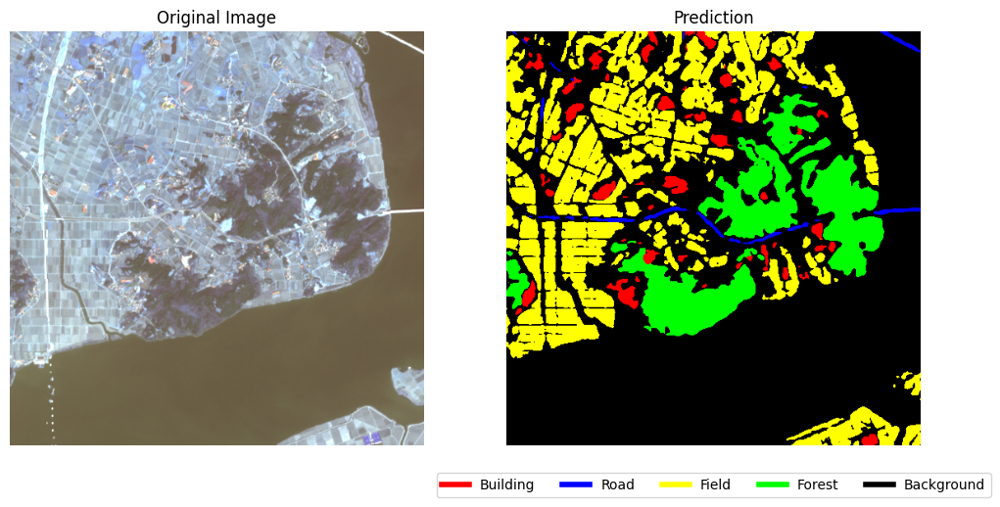

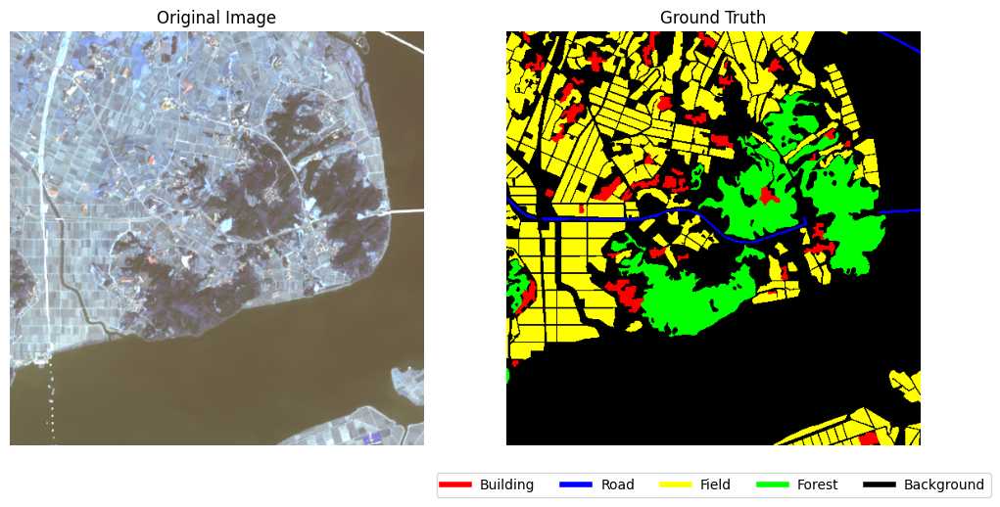

Processing: LC_SN_36604_027.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.4669, Precision=0.5986, Recall=0.6798, F1-Score=0.6366
Class Road: IoU=0.3232, Precision=0.3504, Recall=0.8060, F1-Score=0.4885
Class Field: IoU=0.6544, Precision=0.8441, Recall=0.7444, F1-Score=0.7911
Class Forest: IoU=0.5011, Precision=0.8137, Recall=0.5661, F1-Score=0.6677
Class Background: IoU=0.7252, Precision=0.8172, Recall=0.8656, F1-Score=0.8407

Overall Metrics: Mean IoU=0.5342, Pixel Accuracy=0.8078
Mean IoU: 0.5342, Pixel Accuracy: 0.8078


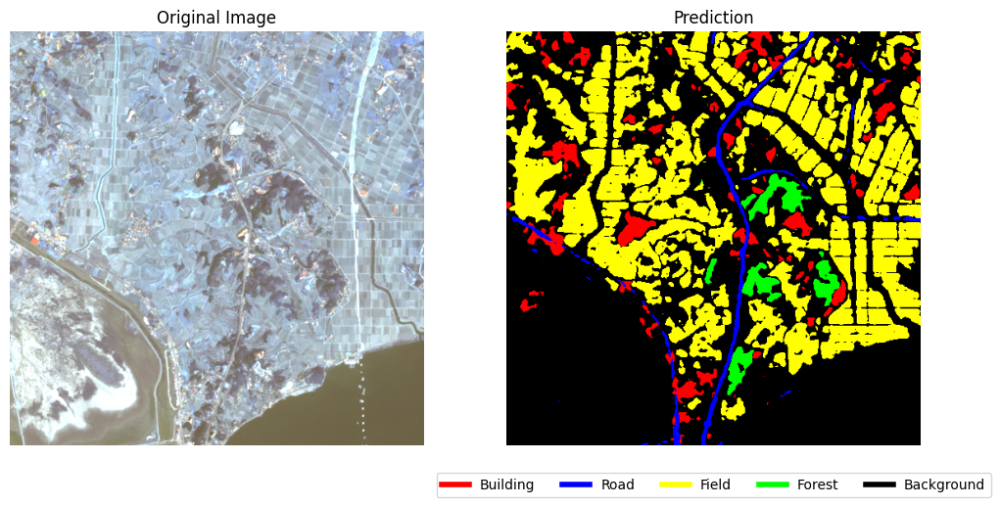

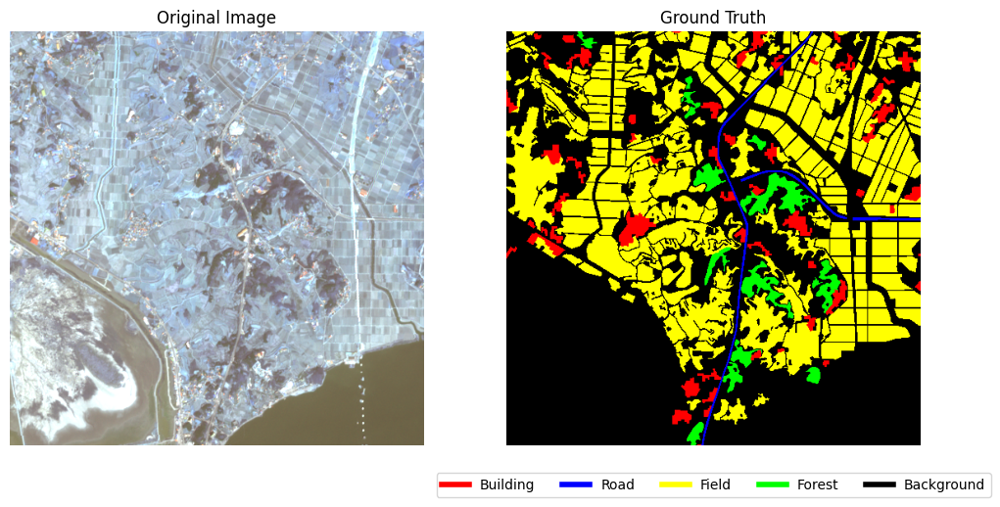

Processing: LC_SN_36604_029.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.4574, Precision=0.6169, Recall=0.6388, F1-Score=0.6277
Class Road: IoU=0.2319, Precision=0.2543, Recall=0.7249, F1-Score=0.3765
Class Field: IoU=0.7632, Precision=0.8862, Recall=0.8461, F1-Score=0.8657
Class Forest: IoU=0.0000, Precision=0.0000, Recall=0.0000, F1-Score=0.0000
Class Background: IoU=0.8562, Precision=0.9279, Recall=0.9172, F1-Score=0.9225

Overall Metrics: Mean IoU=0.4617, Pixel Accuracy=0.8832
Mean IoU: 0.4617, Pixel Accuracy: 0.8832


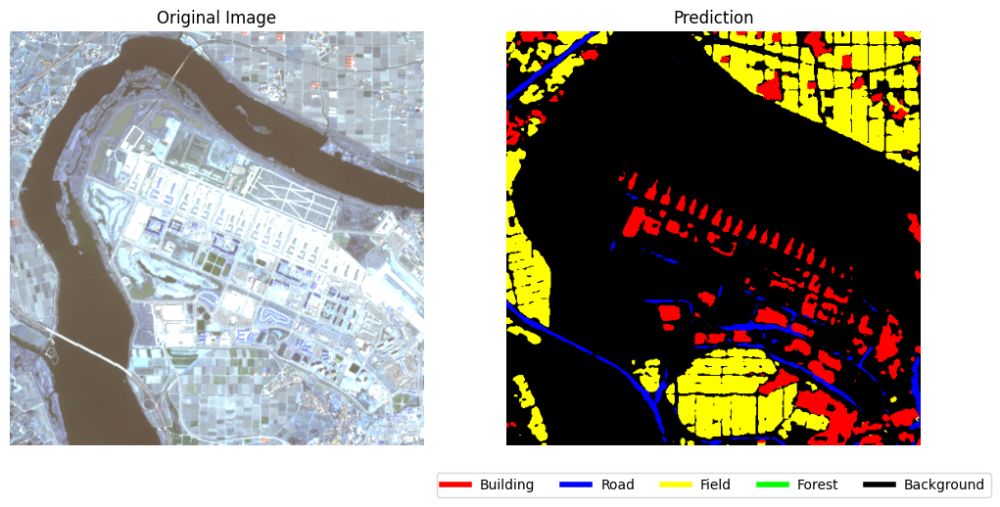

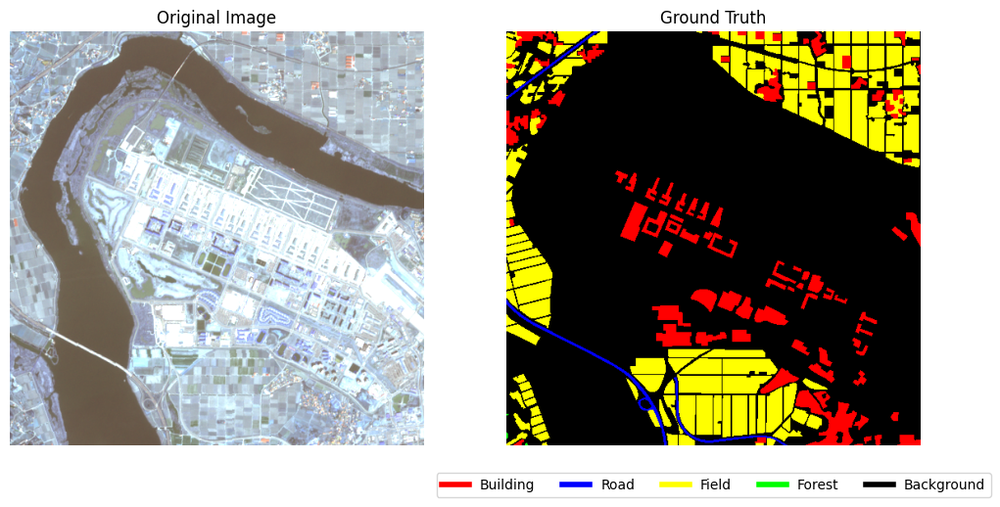

Processing: LC_SN_36604_030.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.6553, Precision=0.8450, Recall=0.7448, F1-Score=0.7918
Class Road: IoU=0.4461, Precision=0.4614, Recall=0.9309, F1-Score=0.6170
Class Field: IoU=0.6853, Precision=0.8359, Recall=0.7918, F1-Score=0.8132
Class Forest: IoU=0.7431, Precision=0.9083, Recall=0.8033, F1-Score=0.8526
Class Background: IoU=0.7085, Precision=0.8146, Recall=0.8448, F1-Score=0.8294

Overall Metrics: Mean IoU=0.6477, Pixel Accuracy=0.8160
Mean IoU: 0.6477, Pixel Accuracy: 0.8160


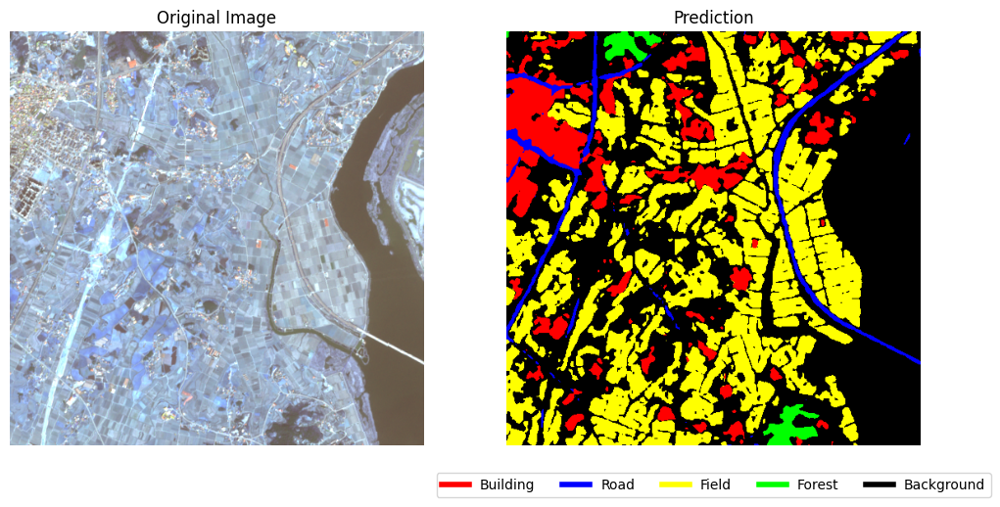

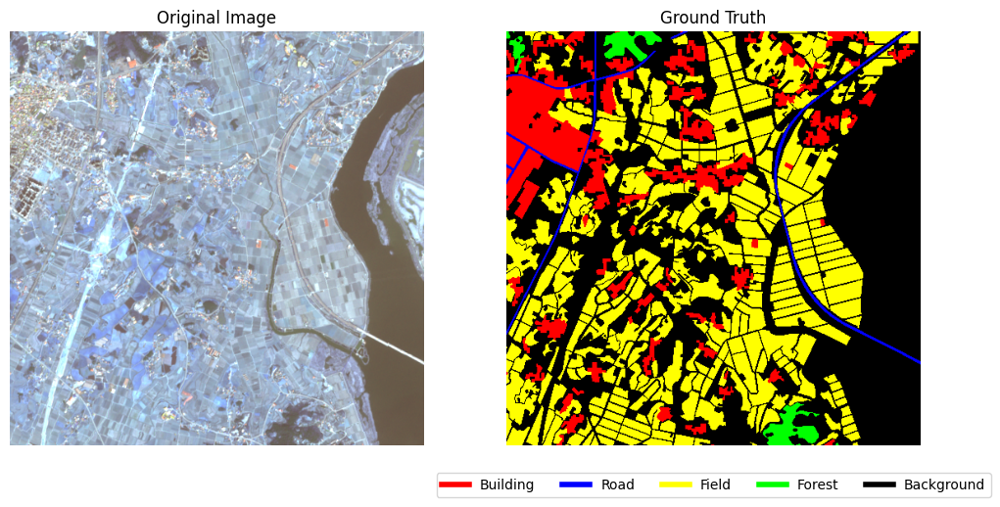

Processing: LC_SN_36604_031.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.6645, Precision=0.8054, Recall=0.7916, F1-Score=0.7985
Class Road: IoU=0.4048, Precision=0.4204, Recall=0.9159, F1-Score=0.5763
Class Field: IoU=0.5800, Precision=0.8168, Recall=0.6668, F1-Score=0.7342
Class Forest: IoU=0.0503, Precision=0.6533, Recall=0.0516, F1-Score=0.0957
Class Background: IoU=0.6180, Precision=0.7217, Recall=0.8113, F1-Score=0.7639

Overall Metrics: Mean IoU=0.4635, Pixel Accuracy=0.7484
Mean IoU: 0.4635, Pixel Accuracy: 0.7484


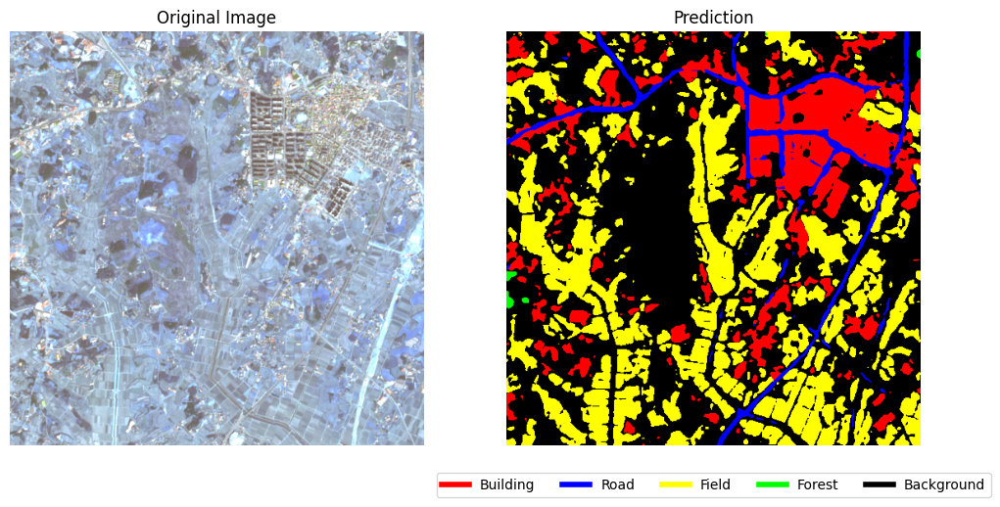

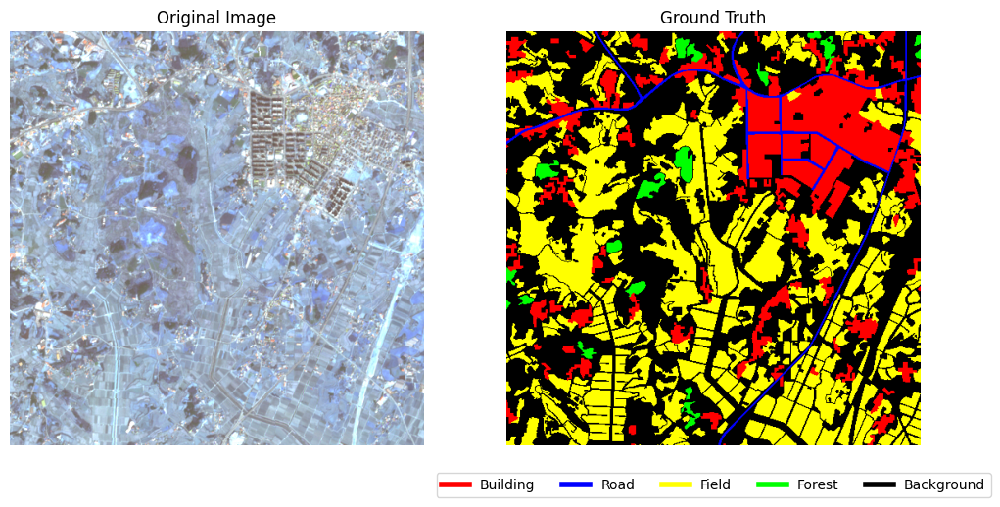

Processing: LC_SN_36604_032.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.6412, Precision=0.7559, Recall=0.8087, F1-Score=0.7814
Class Road: IoU=0.3406, Precision=0.3505, Recall=0.9240, F1-Score=0.5082
Class Field: IoU=0.5924, Precision=0.7990, Recall=0.6962, F1-Score=0.7441
Class Forest: IoU=0.4415, Precision=0.7754, Recall=0.5062, F1-Score=0.6125
Class Background: IoU=0.6672, Precision=0.8241, Recall=0.7780, F1-Score=0.8004

Overall Metrics: Mean IoU=0.5366, Pixel Accuracy=0.7657
Mean IoU: 0.5366, Pixel Accuracy: 0.7657


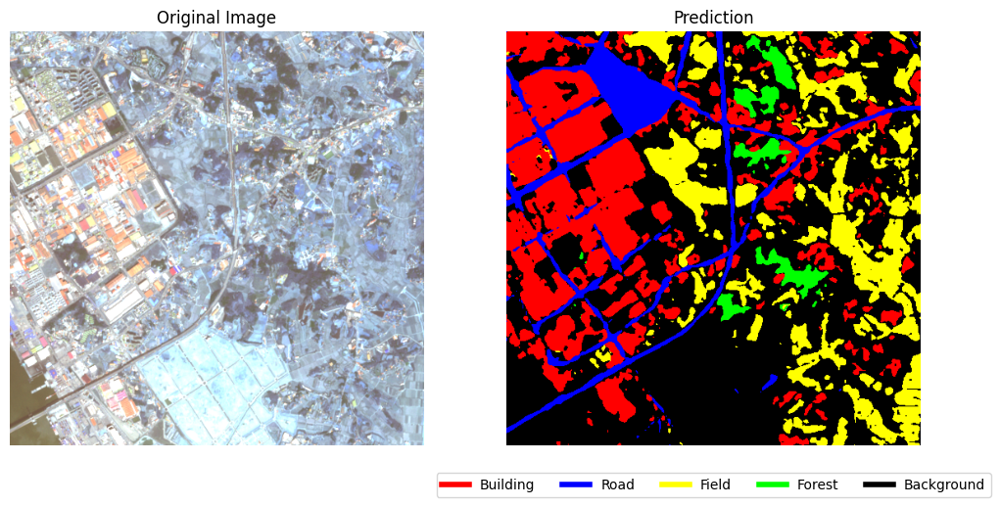

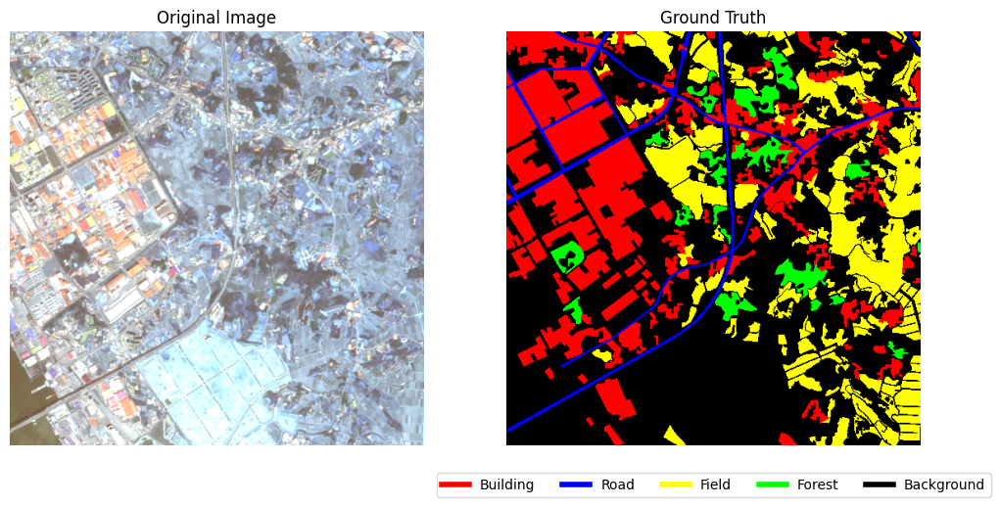

Processing: LC_SN_36701_021.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.5473, Precision=0.8270, Recall=0.6181, F1-Score=0.7074
Class Road: IoU=0.2714, Precision=0.3815, Recall=0.4847, F1-Score=0.4269
Class Field: IoU=0.6933, Precision=0.8210, Recall=0.8167, F1-Score=0.8188
Class Forest: IoU=0.7490, Precision=0.8531, Recall=0.8599, F1-Score=0.8565
Class Background: IoU=0.6948, Precision=0.7930, Recall=0.8488, F1-Score=0.8199

Overall Metrics: Mean IoU=0.5912, Pixel Accuracy=0.8032
Mean IoU: 0.5912, Pixel Accuracy: 0.8032


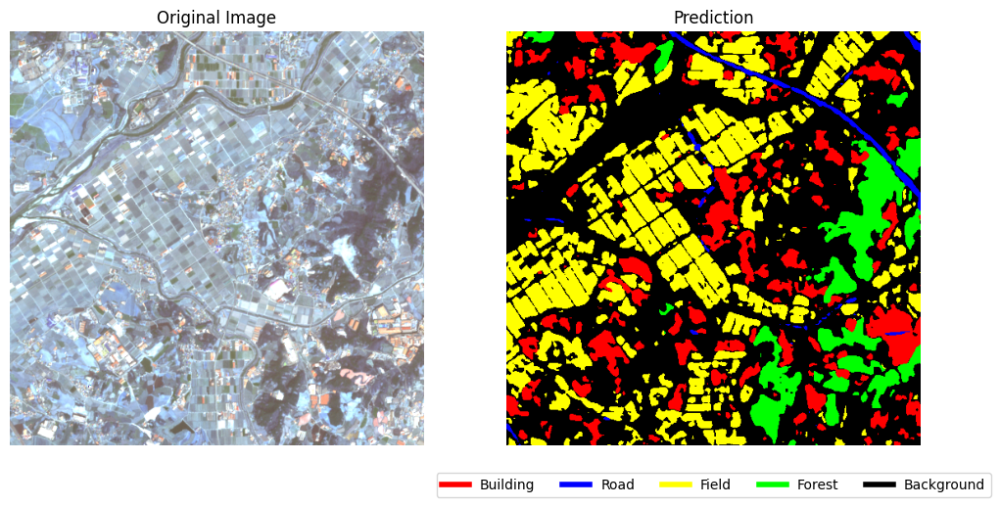

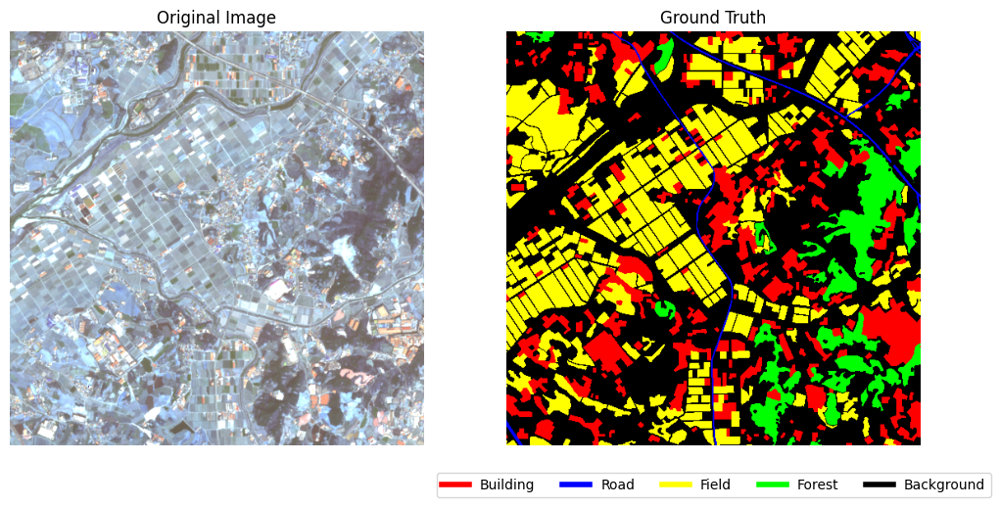

Processing: LC_SN_36701_022.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.5666, Precision=0.8253, Recall=0.6438, F1-Score=0.7233
Class Road: IoU=0.5540, Precision=0.5841, Recall=0.9147, F1-Score=0.7130
Class Field: IoU=0.7180, Precision=0.8497, Recall=0.8224, F1-Score=0.8358
Class Forest: IoU=0.6626, Precision=0.6982, Recall=0.9286, F1-Score=0.7971
Class Background: IoU=0.6826, Precision=0.7837, Recall=0.8411, F1-Score=0.8114

Overall Metrics: Mean IoU=0.6367, Pixel Accuracy=0.8088
Mean IoU: 0.6367, Pixel Accuracy: 0.8088


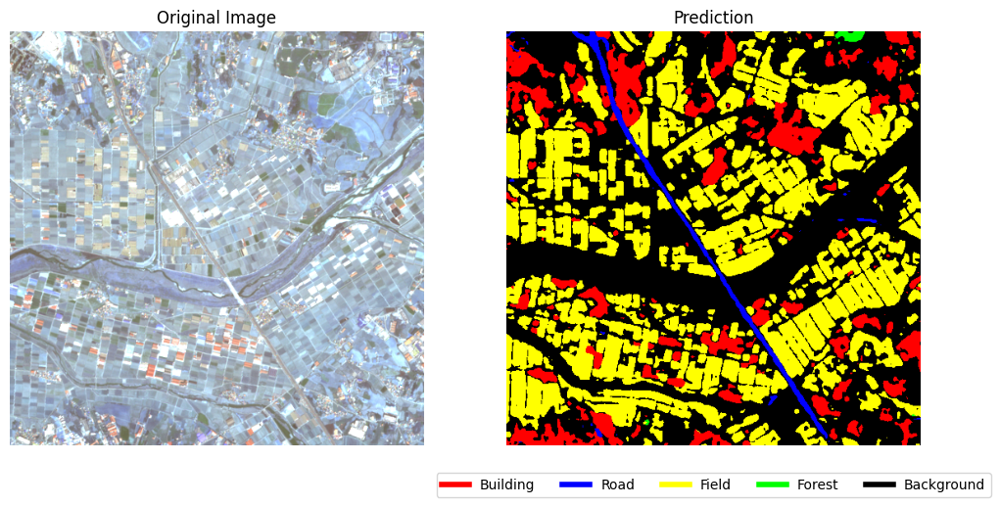

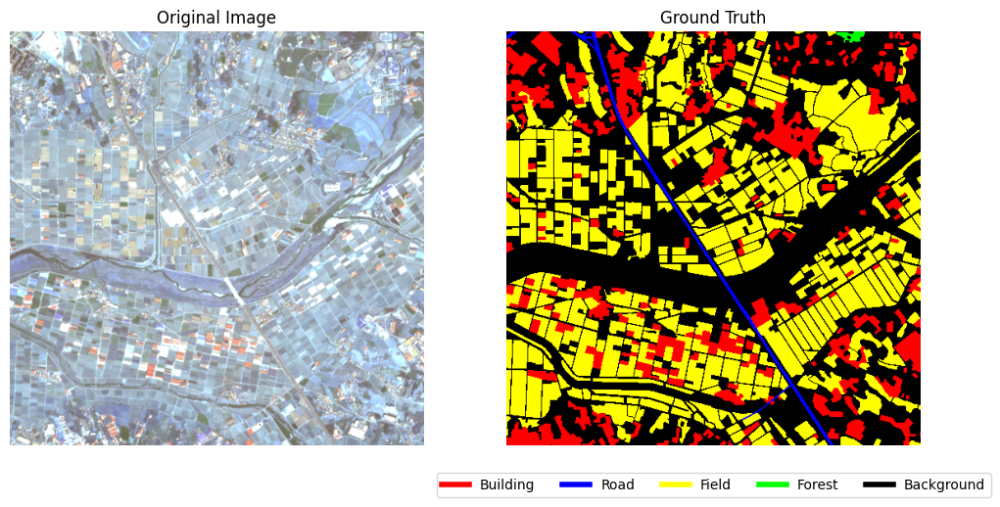

Processing: LC_SN_36701_023.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.6913, Precision=0.8601, Recall=0.7789, F1-Score=0.8175
Class Road: IoU=0.4203, Precision=0.4868, Recall=0.7546, F1-Score=0.5918
Class Field: IoU=0.7637, Precision=0.8860, Recall=0.8469, F1-Score=0.8660
Class Forest: IoU=0.0000, Precision=0.0000, Recall=0.0000, F1-Score=0.0000
Class Background: IoU=0.6607, Precision=0.7721, Recall=0.8208, F1-Score=0.7957

Overall Metrics: Mean IoU=0.5072, Pixel Accuracy=0.8201
Mean IoU: 0.5072, Pixel Accuracy: 0.8201


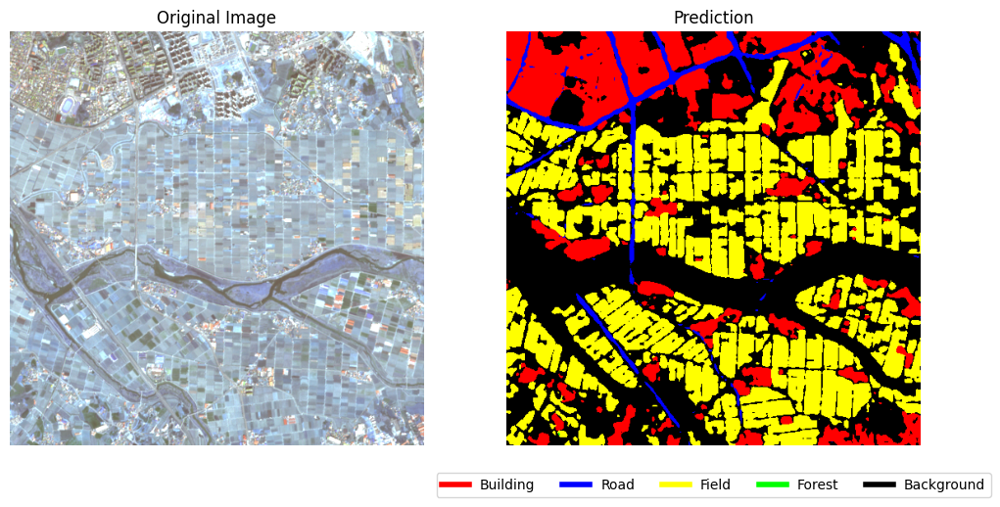

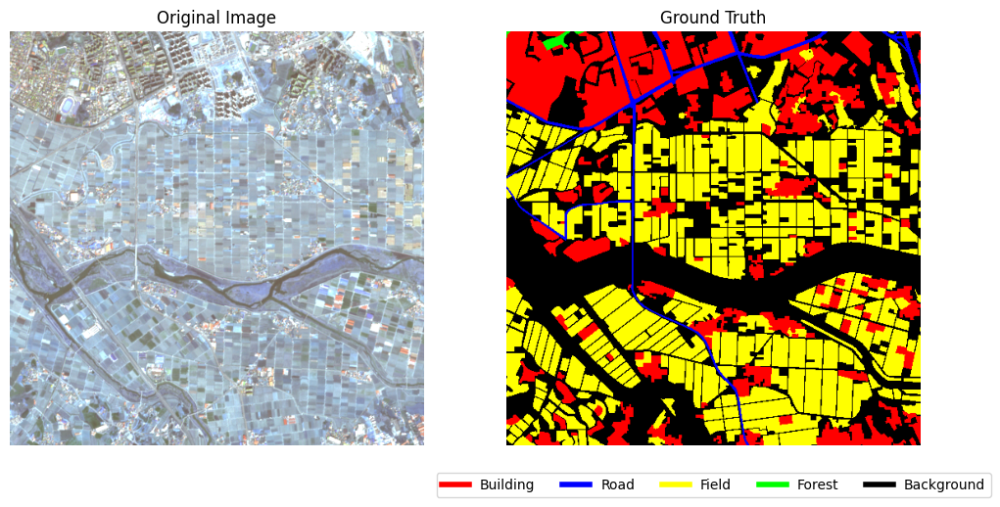

Processing: LC_SN_36701_024.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.7297, Precision=0.8433, Recall=0.8442, F1-Score=0.8437
Class Road: IoU=0.2876, Precision=0.3144, Recall=0.7715, F1-Score=0.4468
Class Field: IoU=0.7146, Precision=0.8605, Recall=0.8082, F1-Score=0.8336
Class Forest: IoU=0.0863, Precision=0.8099, Recall=0.0881, F1-Score=0.1588
Class Background: IoU=0.6493, Precision=0.7857, Recall=0.7891, F1-Score=0.7874

Overall Metrics: Mean IoU=0.4935, Pixel Accuracy=0.8039
Mean IoU: 0.4935, Pixel Accuracy: 0.8039


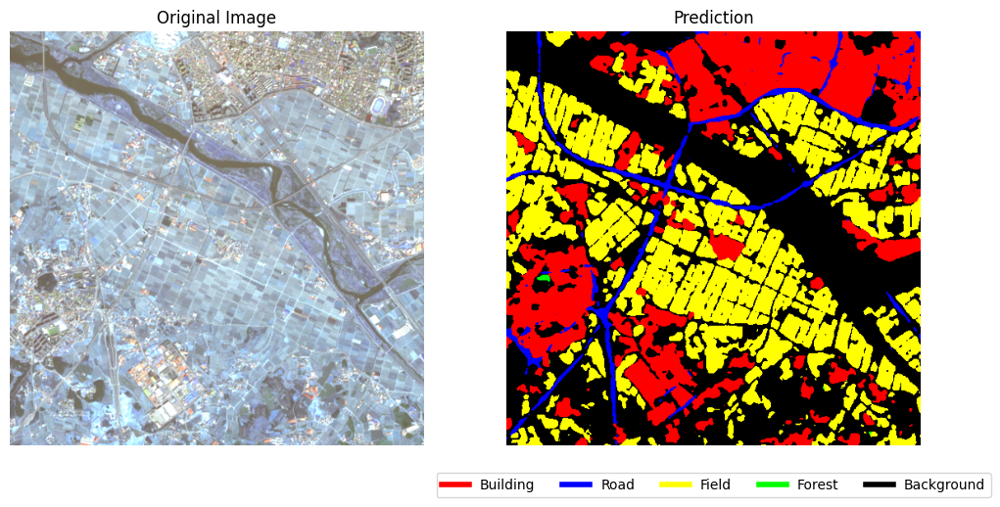

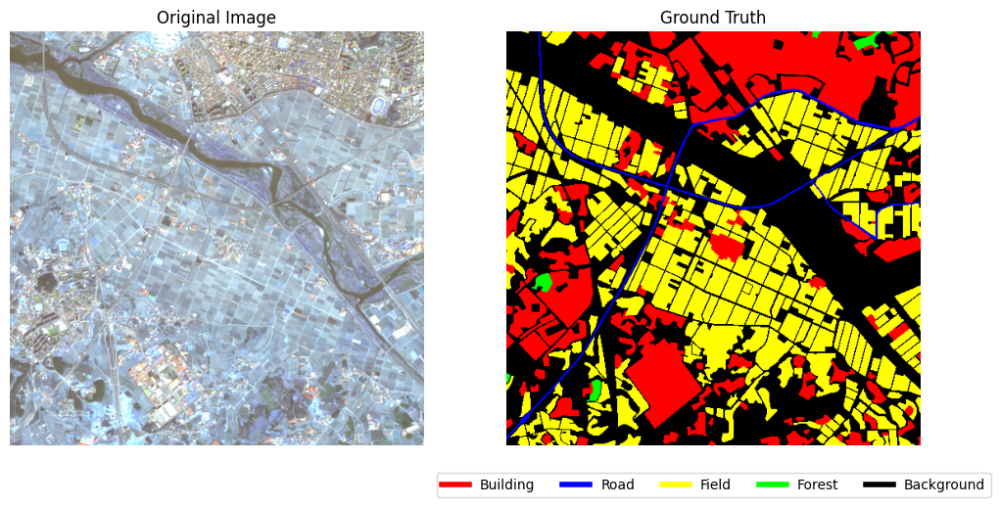

Processing: LC_SN_36701_025.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.6343, Precision=0.7218, Recall=0.8395, F1-Score=0.7762
Class Road: IoU=0.1155, Precision=0.1190, Recall=0.7975, F1-Score=0.2071
Class Field: IoU=0.7348, Precision=0.8689, Recall=0.8264, F1-Score=0.8472
Class Forest: IoU=0.1160, Precision=0.3821, Recall=0.1427, F1-Score=0.2078
Class Background: IoU=0.7662, Precision=0.8927, Recall=0.8439, F1-Score=0.8676

Overall Metrics: Mean IoU=0.4734, Pixel Accuracy=0.8359
Mean IoU: 0.4734, Pixel Accuracy: 0.8359


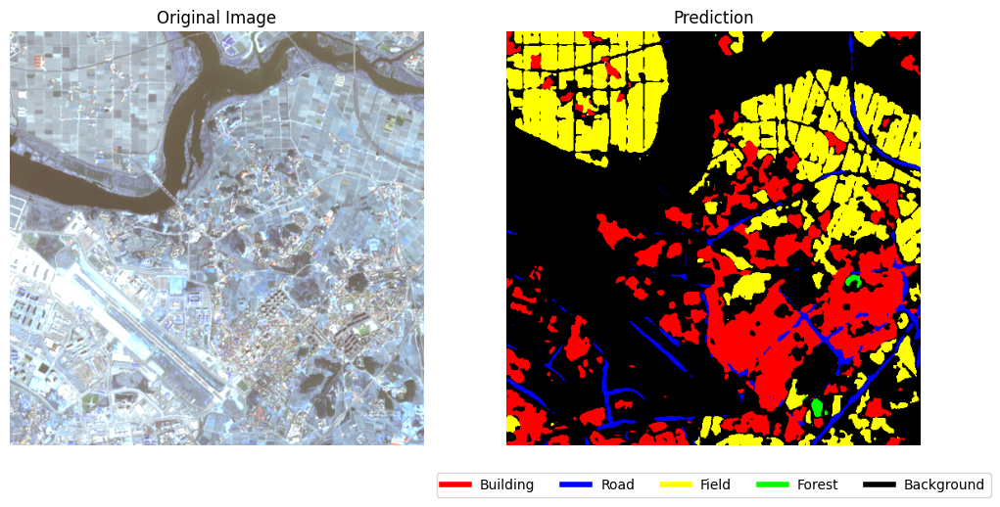

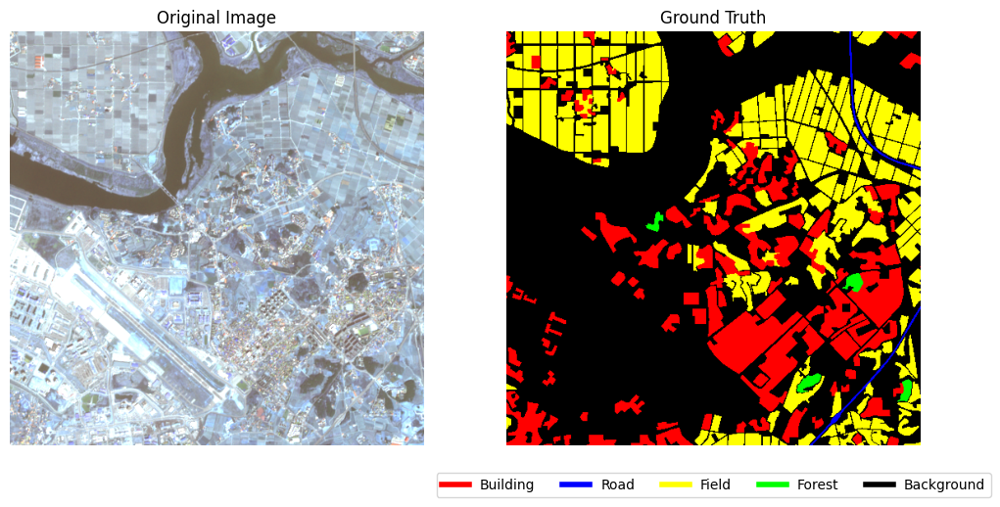

Processing: LC_SN_36702_014.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.2924, Precision=0.3233, Recall=0.7538, F1-Score=0.4526
Class Road: IoU=0.0000, Precision=0.0000, Recall=0.0000, F1-Score=0.0000
Class Field: IoU=0.2824, Precision=0.5452, Recall=0.3694, F1-Score=0.4404
Class Forest: IoU=0.9242, Precision=0.9358, Recall=0.9868, F1-Score=0.9606
Class Background: IoU=0.6371, Precision=0.8838, Recall=0.6953, F1-Score=0.7783

Overall Metrics: Mean IoU=0.4272, Pixel Accuracy=0.9191
Mean IoU: 0.4272, Pixel Accuracy: 0.9191


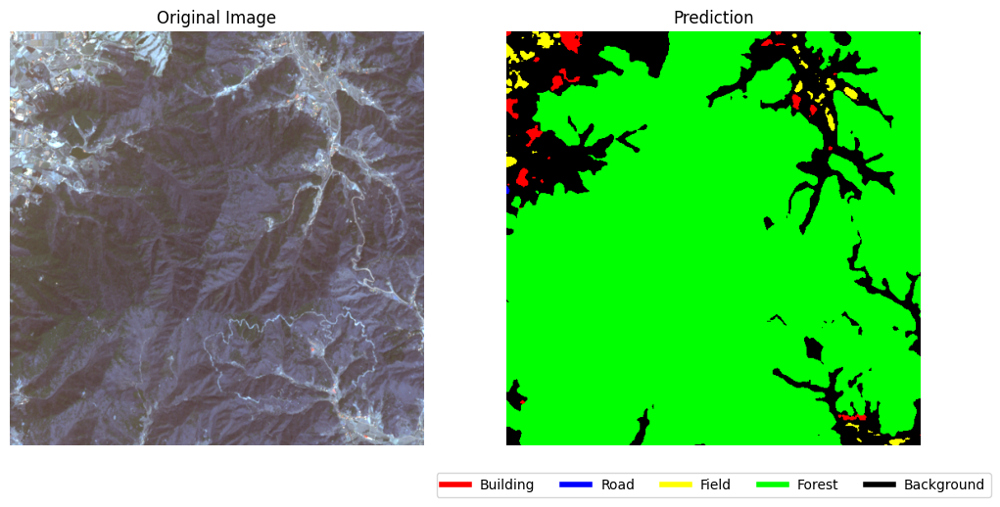

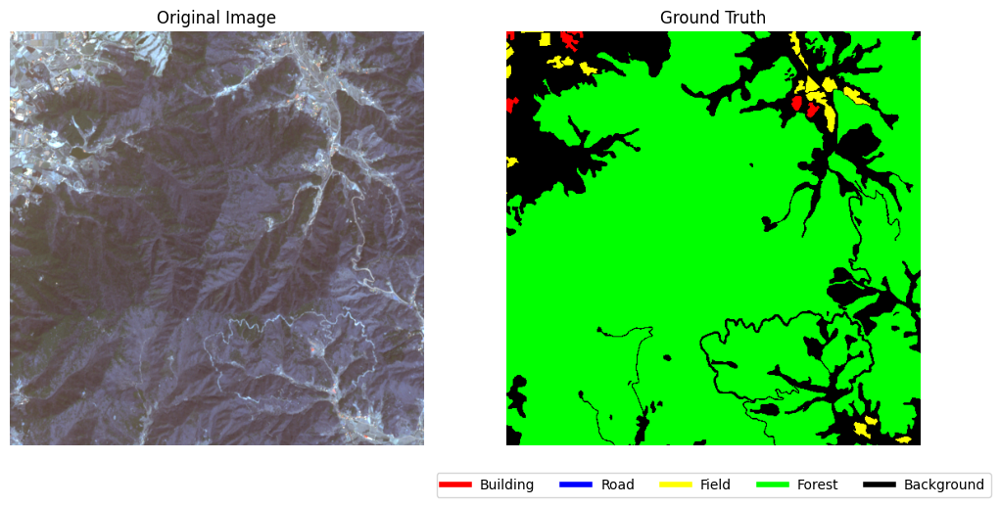

Processing: LC_SN_36702_015.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.5059, Precision=0.6659, Recall=0.6780, F1-Score=0.6719
Class Road: IoU=0.4507, Precision=0.5147, Recall=0.7837, F1-Score=0.6214
Class Field: IoU=0.4275, Precision=0.5184, Recall=0.7092, F1-Score=0.5990
Class Forest: IoU=0.8968, Precision=0.9495, Recall=0.9417, F1-Score=0.9456
Class Background: IoU=0.7184, Precision=0.8665, Recall=0.8078, F1-Score=0.8361

Overall Metrics: Mean IoU=0.5999, Pixel Accuracy=0.8184
Mean IoU: 0.5999, Pixel Accuracy: 0.8184


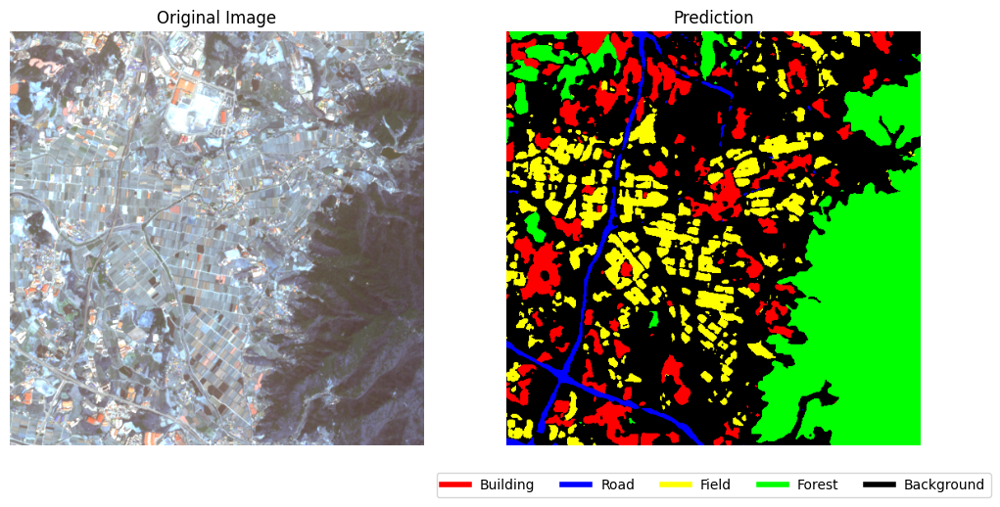

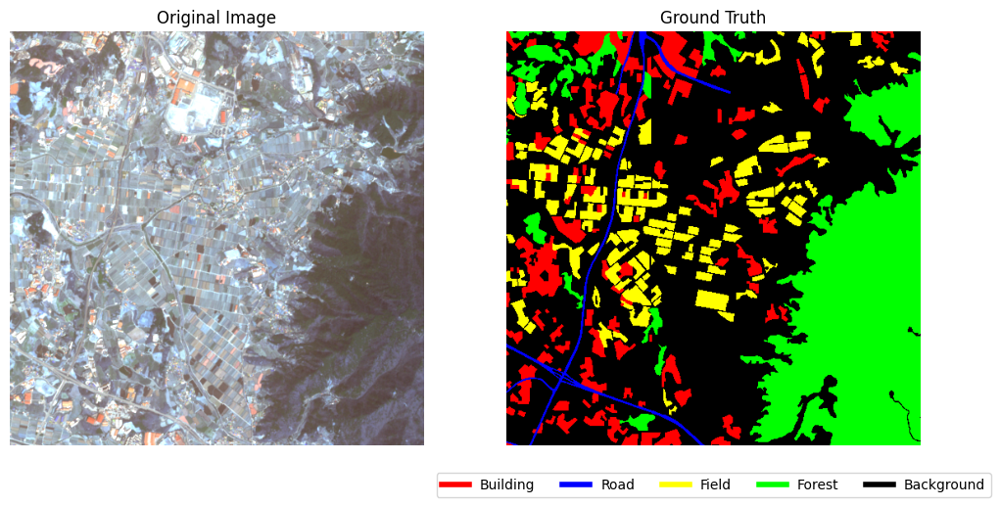

Processing: LC_SN_36702_016.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.4981, Precision=0.5919, Recall=0.7586, F1-Score=0.6650
Class Road: IoU=0.5474, Precision=0.6039, Recall=0.8541, F1-Score=0.7075
Class Field: IoU=0.6673, Precision=0.8015, Recall=0.7994, F1-Score=0.8005
Class Forest: IoU=0.8521, Precision=0.8807, Recall=0.9634, F1-Score=0.9202
Class Background: IoU=0.7114, Precision=0.8811, Recall=0.7870, F1-Score=0.8314

Overall Metrics: Mean IoU=0.6553, Pixel Accuracy=0.8588
Mean IoU: 0.6553, Pixel Accuracy: 0.8588


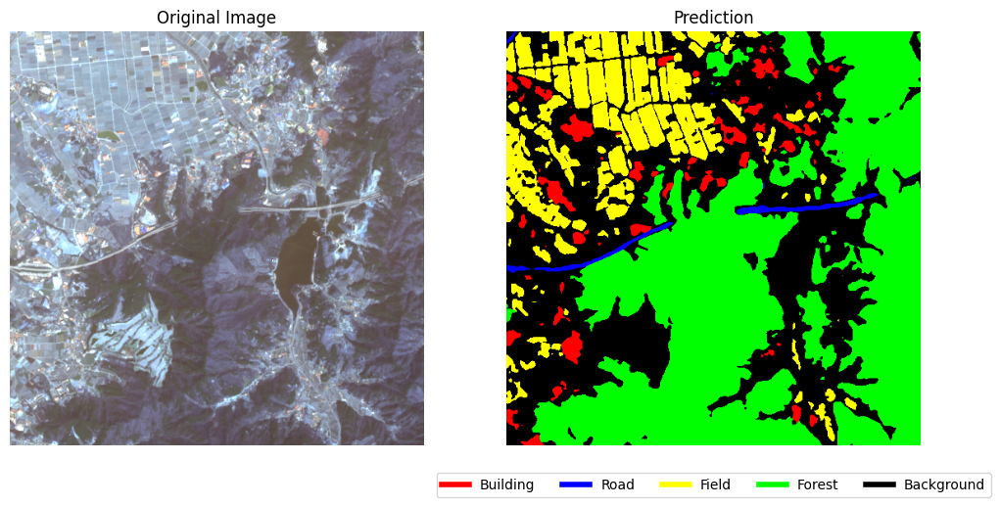

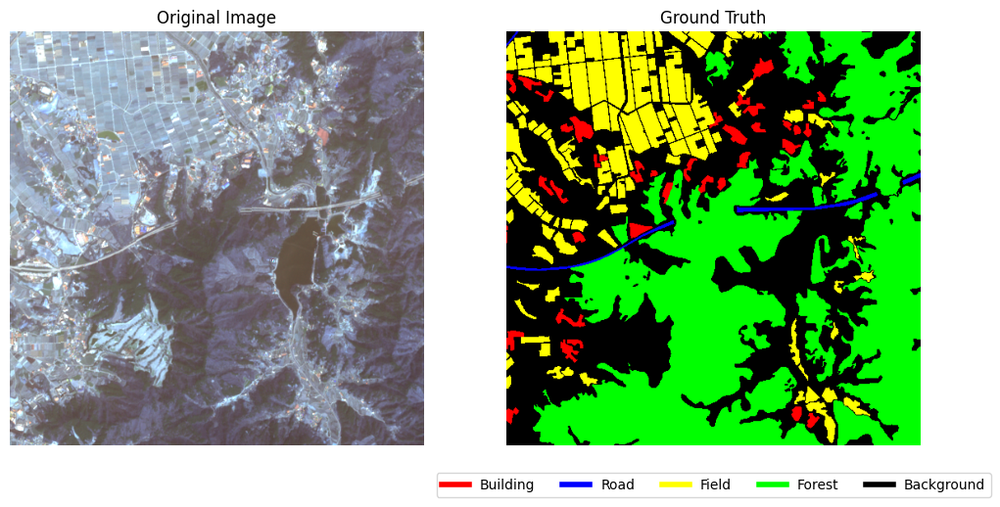

Processing: LC_SN_36702_017.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.5753, Precision=0.7383, Recall=0.7227, F1-Score=0.7304
Class Road: IoU=0.4396, Precision=0.5019, Recall=0.7796, F1-Score=0.6107
Class Field: IoU=0.5530, Precision=0.6796, Recall=0.7481, F1-Score=0.7122
Class Forest: IoU=0.7354, Precision=0.8407, Recall=0.8545, F1-Score=0.8476
Class Background: IoU=0.7021, Precision=0.8429, Recall=0.8078, F1-Score=0.8250

Overall Metrics: Mean IoU=0.6011, Pixel Accuracy=0.7944
Mean IoU: 0.6011, Pixel Accuracy: 0.7944


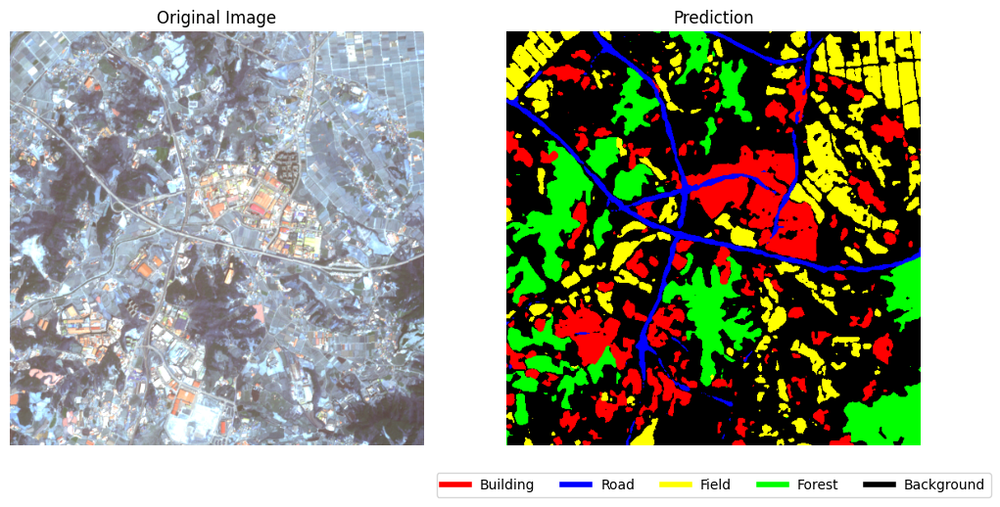

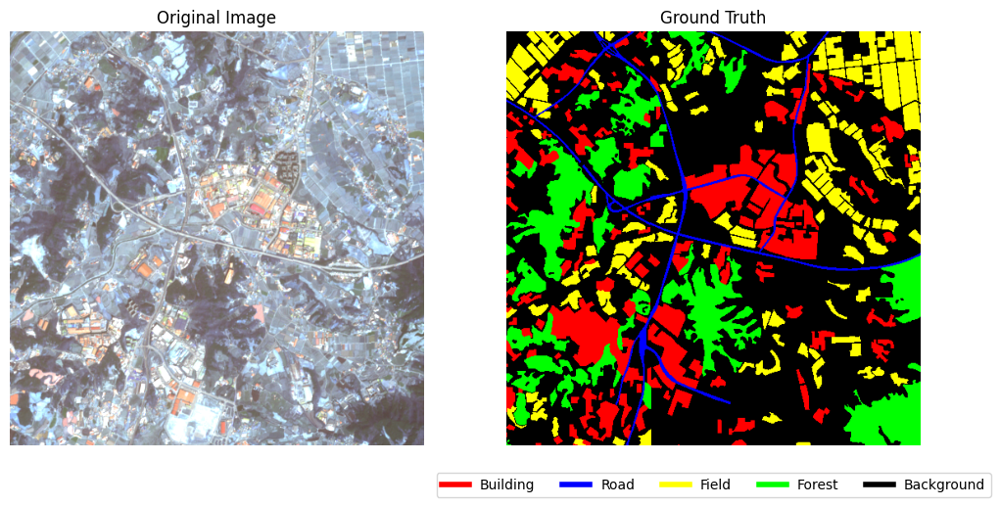

Processing: LC_SN_37604_005.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.6498, Precision=0.8169, Recall=0.7606, F1-Score=0.7877
Class Road: IoU=0.3043, Precision=0.3981, Recall=0.5635, F1-Score=0.4666
Class Field: IoU=0.5517, Precision=0.7985, Recall=0.6408, F1-Score=0.7111
Class Forest: IoU=0.8520, Precision=0.8832, Recall=0.9602, F1-Score=0.9201
Class Background: IoU=0.5990, Precision=0.7552, Recall=0.7434, F1-Score=0.7492

Overall Metrics: Mean IoU=0.5914, Pixel Accuracy=0.8027
Mean IoU: 0.5914, Pixel Accuracy: 0.8027


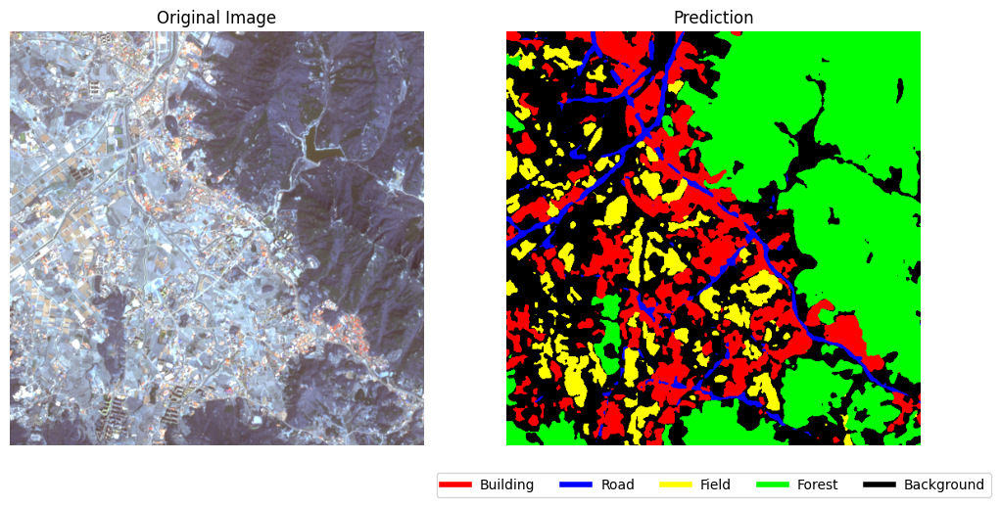

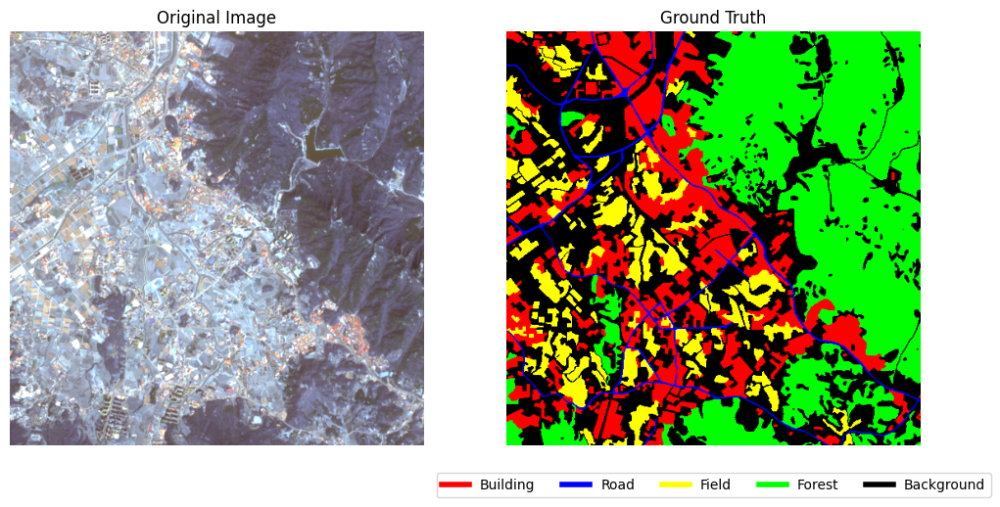

Processing: LC_SN_37604_006.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.5612, Precision=0.8025, Recall=0.6512, F1-Score=0.7190
Class Road: IoU=0.2298, Precision=0.3060, Recall=0.4799, F1-Score=0.3737
Class Field: IoU=0.5163, Precision=0.7810, Recall=0.6036, F1-Score=0.6810
Class Forest: IoU=0.8732, Precision=0.9092, Recall=0.9566, F1-Score=0.9323
Class Background: IoU=0.5782, Precision=0.7231, Recall=0.7426, F1-Score=0.7327

Overall Metrics: Mean IoU=0.5517, Pixel Accuracy=0.8055
Mean IoU: 0.5517, Pixel Accuracy: 0.8055


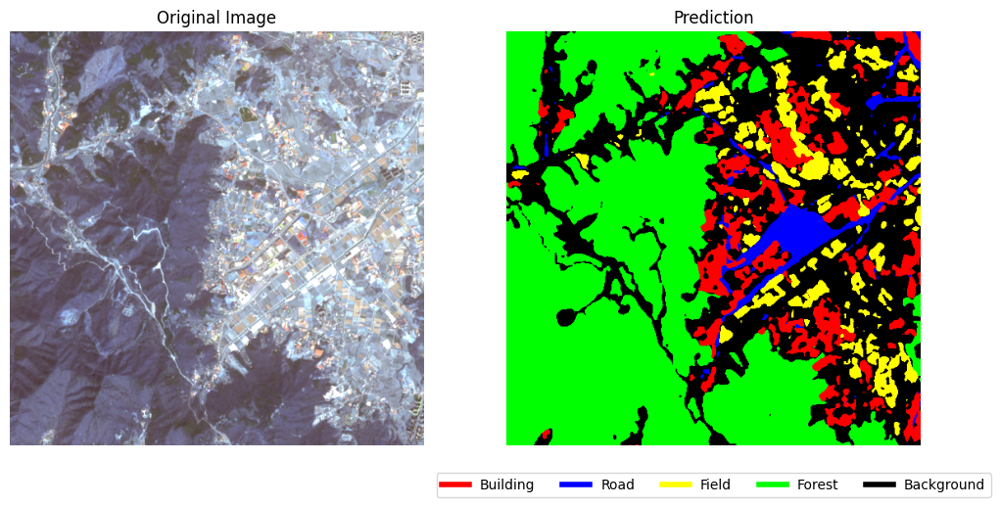

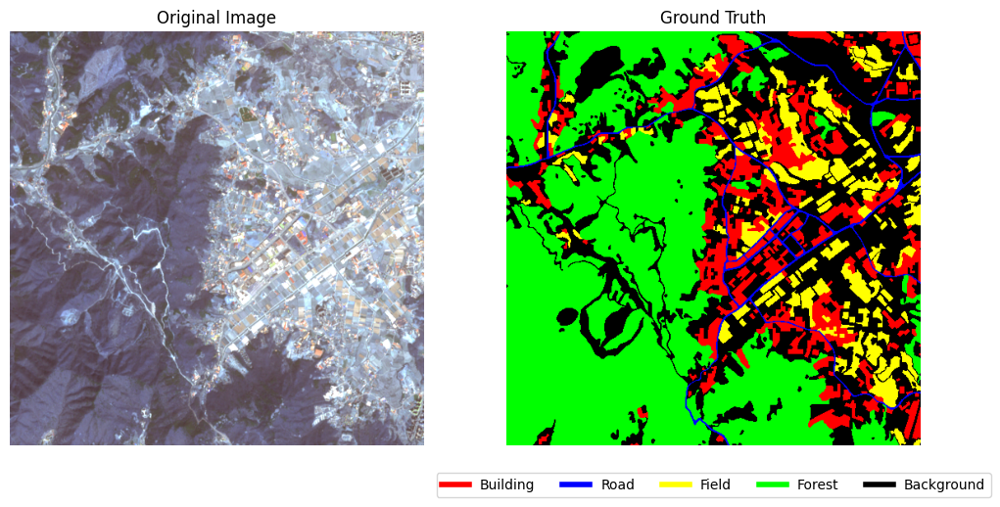

Processing: LC_SN_37604_007.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.3449, Precision=0.8281, Recall=0.3715, F1-Score=0.5129
Class Road: IoU=0.0252, Precision=0.5088, Recall=0.0258, F1-Score=0.0492
Class Field: IoU=0.3077, Precision=0.5794, Recall=0.3961, F1-Score=0.4705
Class Forest: IoU=0.9095, Precision=0.9313, Recall=0.9749, F1-Score=0.9526
Class Background: IoU=0.6860, Precision=0.8115, Recall=0.8160, F1-Score=0.8138

Overall Metrics: Mean IoU=0.4546, Pixel Accuracy=0.8896
Mean IoU: 0.4546, Pixel Accuracy: 0.8896


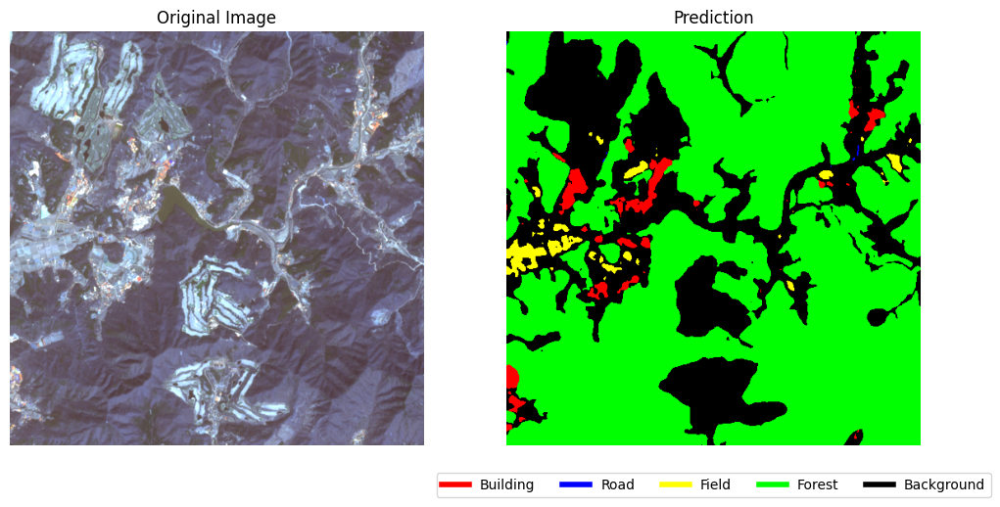

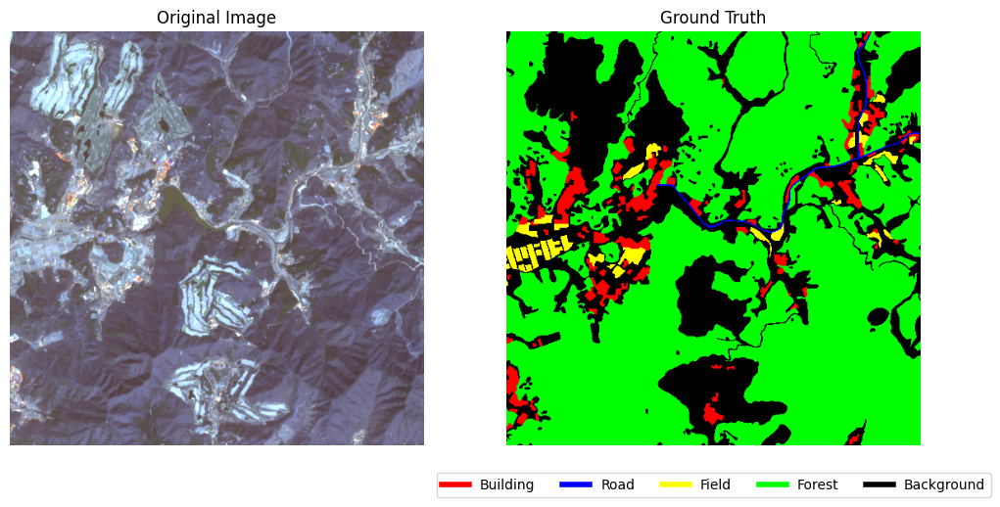

Processing: LC_SN_37604_008.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.6471, Precision=0.8481, Recall=0.7319, F1-Score=0.7857
Class Road: IoU=0.3281, Precision=0.3848, Recall=0.6899, F1-Score=0.4941
Class Field: IoU=0.5374, Precision=0.7641, Recall=0.6443, F1-Score=0.6991
Class Forest: IoU=0.8511, Precision=0.9122, Recall=0.9270, F1-Score=0.9196
Class Background: IoU=0.6557, Precision=0.7770, Recall=0.8076, F1-Score=0.7920

Overall Metrics: Mean IoU=0.6039, Pixel Accuracy=0.8229
Mean IoU: 0.6039, Pixel Accuracy: 0.8229


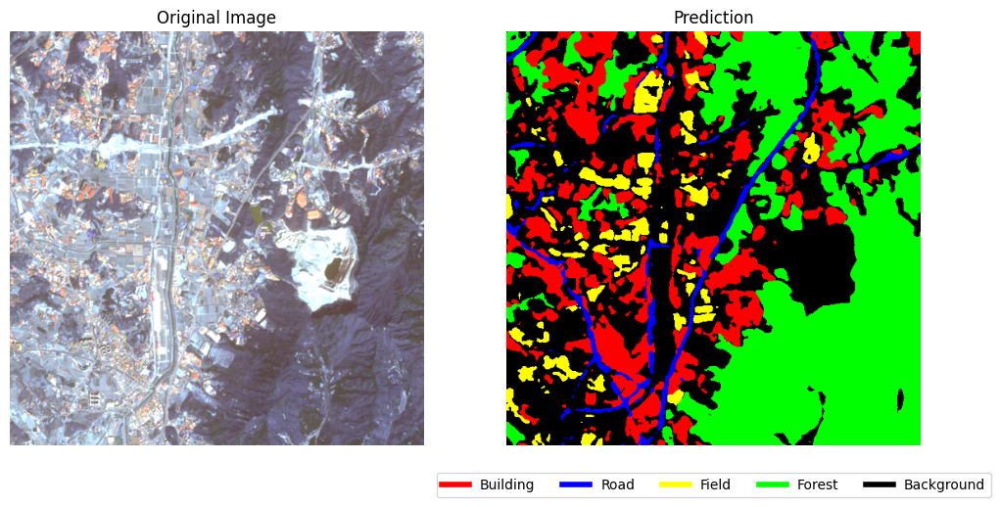

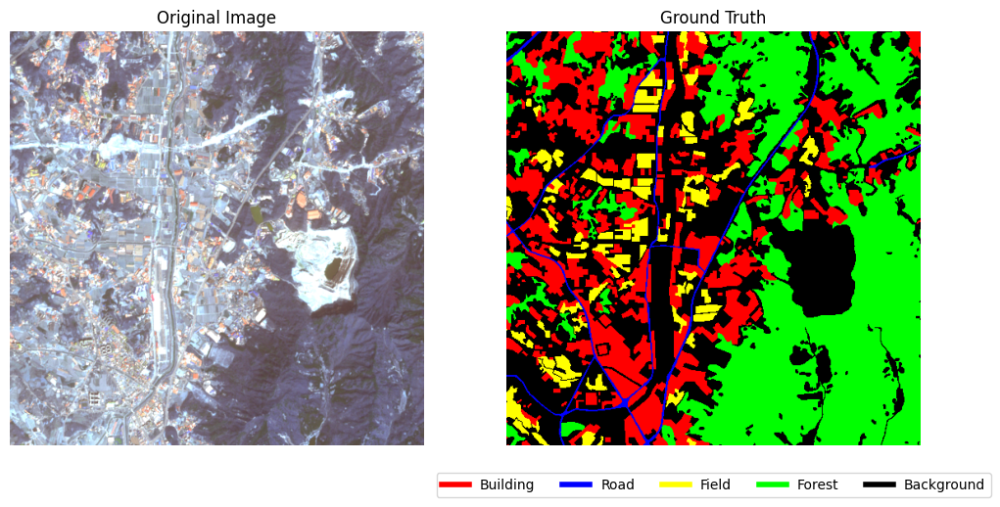

Processing: LC_SN_37604_009.tif
prob_segformer shape: (5, 512, 512)
prob_unet shape: (5, 512, 512)
final_prob shape: (5, 512, 512)
final_prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Class Building: IoU=0.5999, Precision=0.8167, Recall=0.6933, F1-Score=0.7499
Class Road: IoU=0.2938, Precision=0.4303, Recall=0.4809, F1-Score=0.4542
Class Field: IoU=0.4814, Precision=0.6958, Recall=0.6097, F1-Score=0.6499
Class Forest: IoU=0.8125, Precision=0.8713, Recall=0.9233, F1-Score=0.8965
Class Background: IoU=0.6088, Precision=0.7545, Recall=0.7592, F1-Score=0.7568

Overall Metrics: Mean IoU=0.5593, Pixel Accuracy=0.8000
Mean IoU: 0.5593, Pixel Accuracy: 0.8000


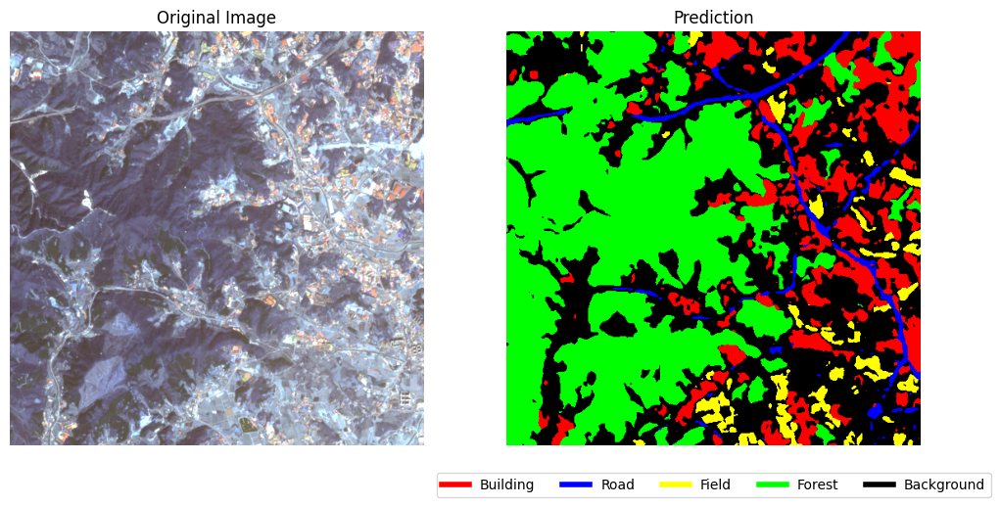

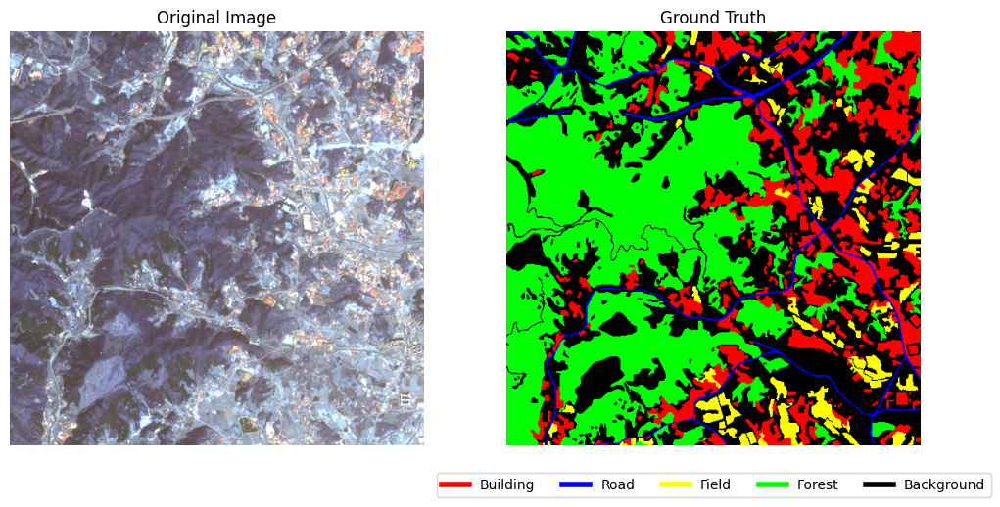


Final Evaluation Results:
Average Mean IoU: 0.5518
Average Pixel Accuracy: 0.8237
Class Building: Average IoU=0.7407, Precision=0.7407, Recall=0.7063, F1-Score=0.7113
Class Road: Average IoU=0.3952, Precision=0.3952, Recall=0.6685, F1-Score=0.4665
Class Field: Average IoU=0.7734, Precision=0.7734, Recall=0.7075, F1-Score=0.7356
Class Forest: Average IoU=0.7457, Precision=0.7457, Recall=0.6679, F1-Score=0.6729
Class Background: Average IoU=0.8156, Precision=0.8156, Recall=0.8119, F1-Score=0.8126


In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def main():
    image_folder = "test_dataset/images"
    mask_folder = "test_dataset/labels"
    num_classes = 5
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    class_mapping = {
        10: 0,  # Building
        30: 1,  # Road
        50: 2,  # Field
        60: 2,  # Merge Field
        71: 3,  # Merge Forest
        75: 3,  # Merge Forest
        70: 3,  # Forest
        90: 2,  # Field (전라도)
        100: 4  # Background
    }
    class_names = ["Building", "Road", "Field", "Forest", "Background"]
    colormap = [
        (255, 0, 0),      # Building (Red)
        (0, 0, 255),      # Road (Blue)
        (255, 255, 0),    # Field (Yellow)
        (0, 255, 0),      # Forest (Green)
        (0, 0, 0)         # Background (Black)
    ]

    unetpp_model = load_UNet_model("weights/UNet++_weights/unetpp_resnet50_epoch_50.pth", num_classes, device)
    segformer_model = load_segformer_model("weights/Segformer_weights(b3)/Segformer_epoch_50.pth", num_classes, device)

    image_transform = transforms.Compose([
        transforms.Lambda(enhance_edges),  # 엣지 보강
        transforms.Lambda(enhance_saturation),  # 채도 강화
        transforms.Lambda(enhance_clahe),  # CLAHE 적용
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    image_files = sorted([f for f in os.listdir(image_folder) if f.endswith(".tif")])
    mask_files = sorted([f for f in os.listdir(mask_folder) if f.endswith(".tif")])

    ########################################
    all_iou = []
    all_pixel_acc = []
    all_precision = []
    all_recall = []
    all_f1 = []
    all_iou_classes = [[] for _ in range(num_classes)]
    all_precision_classes = [[] for _ in range(num_classes)]
    all_recall_classes = [[] for _ in range(num_classes)]
    all_f1_classes = [[] for _ in range(num_classes)]
    ########################################


    for image_file, mask_file in zip(image_files, mask_files):
        image_path = os.path.join(image_folder, image_file)
        mask_path = os.path.join(mask_folder, mask_file)
        print(f"Processing: {image_file}")

        with rasterio.open(image_path) as src:
            image = src.read([1, 2, 3])
            image = np.transpose(image, (1, 2, 0))

        with rasterio.open(mask_path) as src:
            mask = src.read(1)

        ###############################정규화 전처리#########################################
        if image.max() > 255:
            image = np.log1p(image)
            image = ((image - image.min()) / (image.max() - image.min()) * 255).astype(np.uint8)
        else:
            image = image.astype(np.uint8)
        ######################################################################################

        # ✅ 1. 모델 예측 먼저 수행
        input_image = preprocess_image(image, image_transform).to(device)
        mapped_mask = preprocess_mask(mask, class_mapping).cpu().long()

        # ✅ Segformer 예측
        with torch.no_grad():
            output_segformer = segformer_model(input_image)
            prob_segformer = torch.softmax(output_segformer, dim=1).cpu().numpy()  # (1, num_classes, H, W)
            prob_segformer = prob_segformer.squeeze(0)  # (num_classes, H, W)
            pred_segformer = np.argmax(prob_segformer, axis=0)  # (H, W)

        # ✅ UNet++ 예측
        with torch.no_grad():
            output_unet = unetpp_model(input_image)
            prob_unet = torch.softmax(output_unet, dim=1).cpu().numpy()  # (1, num_classes, H, W)
            prob_unet = prob_unet.squeeze(0)  # (num_classes, H, W)
            pred_unet = np.argmax(prob_unet, axis=0)  # (H, W)


##################################soft voting 앙상블##############################################
        alpha = 0.6
        final_prob = alpha * prob_segformer + (1 - alpha) * prob_unet
        final_prediction = np.argmax(final_prob, axis=0)

        softmax_output = np.expand_dims(final_prob, axis=0)
        prediction = final_prediction

        print("prob_segformer shape:", prob_segformer.shape)
        print("prob_unet shape:", prob_unet.shape)
        print("final_prob shape:", final_prob.shape)
        print("final_prediction shape:", final_prediction.shape)

        original_prediction = prediction.copy()
        #prediction = postprocess_segmentation(prediction, kernel_size=5, blur_ksize=1)

        # ✅ 2. 엣지 기반 후처리 적용
        edge_map = create_edge_map(image, low_threshold=200, high_threshold=400)
        #prediction = refine_labels(edge_map, prediction, num_classes, class_mapping)
        prediction = uncertainty_based_road_refine(prediction, softmax_output, threshold=0.7) # 도로 불확실성

        refined_prediction = adaptive_road_filling(prediction, softmax_output, base_threshold=0.08, road_class=1)
        refined_prediction = refine_road_with_edges(refined_prediction, softmax_output, edge_map, threshold = 0.3, road_class = 1)

        refined_prediction = directional_road_filter(refined_prediction, road_class=1, min_length=20, angle_threshold=30, neighborhood_size=2)

        refined_prediction = contour_simplification(refined_prediction, epsilon=0.9, road_class=1)

        # ✅ 4. Torch Tensor 변환
        refined_prediction = torch.tensor(refined_prediction, dtype = torch.long).cpu()

        ########################################################################################
        mean_iou, pixel_accuracy, precision_per_class, recall_per_class, f1_per_class = compute_metrics(refined_prediction, mapped_mask, num_classes, class_names)

        all_iou.append(mean_iou)
        all_pixel_acc.append(pixel_accuracy)

        for i in range(num_classes):
            all_iou_classes[i].append(precision_per_class[i])
            all_precision_classes[i].append(precision_per_class[i])
            all_recall_classes[i].append(recall_per_class[i])
            all_f1_classes[i].append(f1_per_class[i])

        print(f'Mean IoU: {mean_iou:.4f}, Pixel Accuracy: {pixel_accuracy:.4f}')
        visualize_result(image, refined_prediction, colormap, class_names, "Prediction")
        visualize_result(image, mapped_mask.numpy(), colormap, class_names, "Ground Truth")

    avg_iou = np.mean(all_iou)
    avg_pixel_acc = np.mean(all_pixel_acc)

    print(f"\nFinal Evaluation Results:")
    print(f"Average Mean IoU: {avg_iou:.4f}")
    print(f"Average Pixel Accuracy: {avg_pixel_acc:.4f}")

    for i, class_name in enumerate(class_names):
      avg_iou = np.mean(all_iou_classes[i])
      avg_precision = np.mean(all_precision_classes[i])
      avg_recall = np.mean(all_recall_classes[i])
      avg_f1 = np.mean(all_f1_classes[i])
      print(f"Class {class_name}: Average IoU={avg_iou:.4f}, Precision={avg_precision:.4f}, Recall={avg_recall:.4f}, F1-Score={avg_f1:.4f}")

if __name__ == "__main__":
    main()